## Use this Notebook to extract all comments/posts made by authors who post in mental health groups

In [24]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import scipy
import datetime
from subreddit_lists import mentalhealth_subreddits

In [25]:
"""
Subreddit lists according to subject matter

Subjects- Mental health, LOA, Advice, New Age, Others
"""

mentalhealth_subreddits = [
                  'Anxiety',
                  'add',
                  'addiction',
                  'ADHD',
                  "ADHD_partners",
                  "ADHDPartners",
                  "adhdwomen",
                  "adhdmeme",
                  'Anger',
                  'alcoholism',
                  "alcoholicsanonymous",
                  "amiugly",
                  "amIuglyBrutallyHonest",
                  "antidepressants",
                  'anxiety_help',
                  'Anxietyhelp',
                  'anxietysuccess',
                  "AnxiousAttachment",
                  'autism',
                  "AutisticPride",
                  'aspergers',
                  "aspergirls",
                  'ARFID',
                  "AvPD",
                  "abusiverelationships",
                  'behavior',
                  'BingeEatingDisorder',
                  'Bingeeating',
                  'behaviortherapy',
                  'bipolar',
                  "bipolar2",
                  'BipolarReddit',
                  'BipolarSOs',
                  'BodyAcceptance',
                  'BodyDysmorphia',
                  "BorderlinePDisorder",
                  'BPD',
                  "BPDlovedones",
                  'Bullimia',
                  'cfs',
                  'criplingalcoholism',
                  'CPTSD',
                  "CPTSDNextSteps",
                  'depression',
                  'depressed',
                  'depression_help',
                  'disorder',
                  'distractit',
                  "Divorce",
                  'domesticviolence',
                  'downsyndrome',
                  "dpdr",
                  'Dysmorphicdisorder',
                  'EatingDisorderHope',
                  'Eatingdisorders',
                  "EDAnonymous",
                  "EDanonymemes",
                  'emetophobia',
                  "emotionalneglect",
                  'EOOD',
                  'ForeverAlone',
                  'GFD',
                  'helpme',
                  "HealthAnxiety",
                  "iamatotalpieceofshit",
                  'lonely',
                  "MaladaptiveDreaming",
                  'mentalhealth',
                  'mentalillness',
                  'MMFB',
                  'MSTsurvivors',
                  'narcissisticparents',
                   'NarcissisticAbuse',
                  "Needafriend",
                  'neurodiversity',
                  "nosurf",
                  'OCD',
                  'OCPD',
                  'Phobia',
                  'Phobias',
                  'ptsd',
                  'PMDD',
                  "Psychosis",
                  "ROCD",
                  'rapecounseling',
                  'rape',
                  'raisedbynarcissists',
                  'sad',
                  'schizophrenia',
                  'schizoaffective',
                  'selfharm',
                  'selfhelp',
                  'socialanxiety',
                  'socialskills',
                  'survivorsofabuse',
                  "SuicideWatch",
                  "TeenAmIUgly",
                  'tourettes',
                  'upset',
                  'ugly'
]

loa_subreddits = [
                'lawofattraction',
                 'NevilleGoddard',
                 'nevillegoddardsp',
                  "NevilleGoddard2",
                  "NevilleGAZSP",
                  "ALLISMIND",
                  "lawofassumptionlw1505",
                  "LawofAttractionAdvice",
                  "manifestationvalley"
]

philosophies_subreddits= [
                "nihilism",
                "stoicism",
                "Absurdism",
                "Existentialism",
                "Pessimism"
]

newage_subreddits = [
                'Psychic',
                'spirituality',
                "AstralProjection",
                  "twinflames",
                  "astrology",
                  "witchcraft",
                  "AskAstrologers",
                  "awakened",
                  "tarot",
                  "JosephMurphy",
                  "Meditation",
                  "shiftingrealities",
                  "Soulnexus",
                  "ALLISMIND",
                  "Psychonaut",
                  "occult",
                  "astrologyreadings",
                  "energy_work",
                  "shrooms",
                  "Glitch_in_the_Matrix",
                  "LucidDreaming",
                  "Dreams",
                  "Empaths",
                  "EscapingPrisonPlanet",
                  "Mediums",
                  "tarotreadings",
                  "Tarotpractices",
                  "magick",
                  "Paranormal",
                  "WitchesVsPatriarchy",
                  "Spells",
                  "Buddhism"
]


advice_subreddits = ['AskReddit',
                    'relationship_advice',
                     "TrueOffMyChest",
                     "unpopularopinion",
                     "offmychest",
                     "Advice",
                     "AmItheAsshole",
                     "AskMen",
                     "BreakUps",
                     "dating_advice",
                     "relationships",
                     "AskWomen",
                     "NoStupidQuestions",
                     "ExNoContact",
                     "dating",
                     "UnsentLetters",
                     "TooAfraidToAsk",
                     "Vent",
                     "AMA",
                     "Tinder",
                     "AskDocs",
                     "seduction",
                     "AskWomenOver30",
                     "Crushes",
                     "FemaleDatingStrategy",
                     "datingoverthirty",
                     "attachment_theory",
                     "AnxiousAttachment",
                     "AmITheDevil",
                     "TalkTherapy",
                     "morbidquestions",
                     "Codependency"
]

others_subreddit = ['NoFap',
                    'Subliminal',
                    "conspiracy",
                    "teenagers",
                    "Semenretention",
                    "antiwork",
                    "selfimprovement",
                    "stopdrinking",
                    "socialskills",
                    "infp",
                    "LSD",
                    "Entrepreneur",
                    "Drugs",
                    "weed",
                    "intermittentfasting",
                    "vegan",
                    "fasting",
                    "loseit",
                    "infj",
                    "DMT",
                    "LifeProTips",
                    "DecidingToBeBetter",
                    "mbti",
                    "PurplePillDebate",
                    "intj",
                    "ENFP",
                    "howtonotgiveafuck",
                    "DecidingToBeBetter"
]

In [32]:
"""
Given a subreddit, get posts and comments made by authors on this subreddit.

"""
def get_author_posts_df(sub):
    
    df_subreddit = pd.DataFrame()

    comment_file = f"{sub}/{sub}_comments.csv"
    posts_file = f"{sub}/{sub}_posts.csv"

    df = pd.read_csv(comment_file)
    df = df[['isodate','subreddit', 'author','body']]
    df['source'] = sub
    df_subreddit = pd.concat([df_subreddit, df])

    df = pd.read_csv(posts_file)
    df = df.rename({'selftext': 'body'}, axis=1)
    df = df[['isodate','subreddit','author', 'body']]
    df['source'] = sub
    df_subreddit = pd.concat([df_subreddit, df])

    df_subreddit['isodate'] = pd.to_datetime(df_subreddit["isodate"])

    return df_subreddit

def get_common_authors_posts(df_subreddit, subreddit_list, sub_name):
    
    #Extract authors posting in subject2 subreddits as well
    df_common = df_subreddit[df_subreddit["subreddit"].isin(subreddit_list)] 
    m_authors = list(df_common['author'].unique())
    print("Number of unique authors :", len(m_authors))

    #Extract all posts from these authors
    df_common_author_posts = df_subreddit[df_subreddit["author"].isin(m_authors)]
    df_common_author_posts = df_common_author_posts[df_common_author_posts['author']!="[deleted]"] 
    df_common_author_posts = df_common_author_posts[df_common_author_posts['body']!="[deleted]"] 
    df_common_author_posts = df_common_author_posts[df_common_author_posts['body']!="[removed]"]
    df_common_author_posts["body"].fillna(" ", inplace = True)
    
    df_common_author_posts.to_csv(f'{sub_name}/{sub_name}_mentalhealth_common_author_posts.csv', index = False)
    
    return df_common_author_posts

In [30]:
"""
Load dataframe from a subreddit
"""

subreddit = 'NevilleGoddard'

df_subreddit = get_author_posts_df(subreddit)

print(df_subreddit.shape)
df_subreddit.head()

(99001, 5)


,isodate,subreddit,author,body,source
0,2022-10-22 20:44:54,Mayhem,Sufficient-Anybody98,AUUUUGGHHHHHHHH YESSS DEADDD XBBXHSUZYXRXRXNSN...,NevilleGoddard
1,2022-10-22 12:46:14,Mayhem,Sufficient-Anybody98,sdd,NevilleGoddard
2,2022-10-22 12:44:17,NevilleGoddard,Sufficient-Anybody98,okie,NevilleGoddard
3,2022-10-22 12:40:29,NevilleGoddard,Sufficient-Anybody98,thats dead not varg. varg is still alive,NevilleGoddard
4,2022-10-22 02:59:42,Mayhem,Sufficient-Anybody98,i would MIAU if i saw this in the shops,NevilleGoddard


In [31]:
"""
Here I'm retrieving all authors who posted in given subreddit and in one of mental health forums.
And then to analyze their posts, I'm extracting all comments and posts ever made by these authors in any subreddit.
"""

common_author_posts = get_common_authors_posts(df_subreddit, mentalhealth_subreddits, subreddit)
print(common_author_posts.shape)
common_author_posts.head()

Number of unique authors : 624
(13943, 5)


,isodate,subreddit,author,body,source
147,2022-10-22 07:06:55,NevilleGoddard,DisastrousNight7229,Was looking for an outsider's perspective.,NevilleGoddard
148,2022-10-22 07:06:30,NevilleGoddard,DisastrousNight7229,Are you limiting contact with them? How do you...,NevilleGoddard
149,2022-10-22 05:13:46,Vindicta,DisastrousNight7229,It was a combination of things I believe. Main...,NevilleGoddard
150,2022-10-21 14:16:30,NevilleGoddard,DisastrousNight7229,Had no idea he talked about this. Thank you so...,NevilleGoddard
151,2022-10-21 13:45:52,Vindicta,DisastrousNight7229,This is most likely not what you mean by an un...,NevilleGoddard


<AxesSubplot: xlabel='subreddit'>

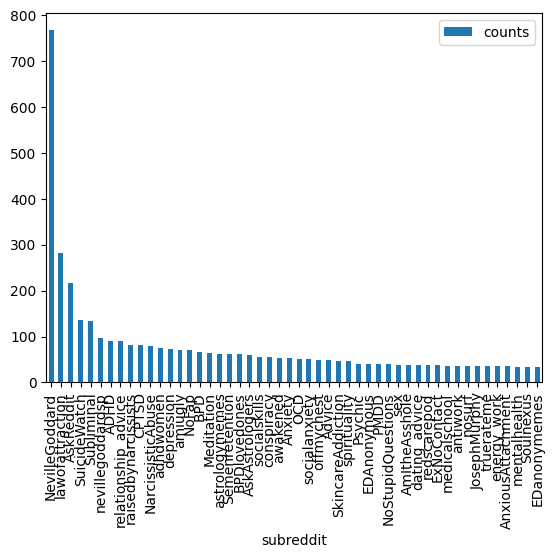

In [22]:
"""
Most frequently posted subreddits by these authors
"""

sub_counts = common_author_posts.\
            groupby(by = 'subreddit').\
            size().\
            reset_index(name = 'counts').\
            sort_values(by = 'counts', ascending = False)

sub_counts = sub_counts.set_index('subreddit')
sub_counts = sub_counts[sub_counts['counts'] > 3]
sub_counts.head(50).plot(kind='bar')


In [20]:
"""
Author activity preview
"""
yearly_count = common_author_posts.groupby(["author", common_author_posts['isodate'].map(lambda x: x.year), "subreddit" ]).size().reset_index(name = 'counts')
yearly_count.head(50)

,author,isodate,subreddit,counts
0,1789isajl,2018,BoneandStone,1
1,1789isajl,2018,MakeNewFriendsHere,1
2,1789isajl,2018,Needafriend,2
3,1789isajl,2018,Psychic,1
4,1789isajl,2018,astrology,1
5,1789isajl,2018,astrologyreadings,3
6,1789isajl,2019,AskAstrologers,1
7,1789isajl,2019,AstrologyChartShare,1
8,1789isajl,2019,Paranormal,1
9,1789isajl,2019,Psychic,1


## Draw network

In [31]:
sub_count_dict = sub_counts.set_index('subreddit').T.to_dict('list')

In [32]:
subs = list(common_author_posts.subreddit.unique())

In [18]:
edge_df = common_author_posts.value_counts().reset_index(name = 'counts')
edge_df.counts.value_counts()
print(edge_df.shape)
edge_df.head(10)

(13940, 6)


,isodate,subreddit,author,body,source,counts
0,2022-01-20 17:02:36,Meditation,societal_outkast,And man I wasn't ready for that!! I was not e...,NevilleGoddard,2
1,2021-10-24 04:12:16,GoodNotes,mydreamsthrowaway,I had a PDF for lessons on which I would take ...,NevilleGoddard,2
2,2020-03-22 06:59:15,vedicastrology,jpo547,,NevilleGoddard,2
3,2022-06-06 17:13:08,careeradvice,trying2passmyclasses,If I’m recently connected with my new manager ...,NevilleGoddard,1
4,2022-06-05 21:18:29,salesforce,frenchfriesforever_,Do you mind sharing how you studied the material?,NevilleGoddard,1
5,2022-06-05 22:03:41,salesforce,frenchfriesforever_,Thank you.,NevilleGoddard,1
6,2022-06-06 00:06:16,CPTSD,SunnyRaspberry,Just sucks. It’s a mysterious phenomenon and m...,NevilleGoddard,1
7,2022-06-06 05:52:04,DocMartin,SlaversBae,,NevilleGoddard,1
8,2022-06-06 07:54:23,aviation,mhbehnke,"It goes fast and shoots guns, 'nuff said",NevilleGoddard,1
9,2022-06-06 10:26:33,salesforce,frenchfriesforever_,That’s what I’m trying to figure out what to d...,NevilleGoddard,1


In [34]:
plt.figure(figsize=(100, 100))

g = nx.from_pandas_edgelist(edge_df, source='source', target='subreddit', edge_attr = 'counts') 

g.remove_edges_from(nx.selfloop_edges(g))

layout = nx.spring_layout(g,iterations=1,scale=2)

sub_size = [sub_count_dict[sub][0]*80 for sub in subs]
nx.draw_networkx_nodes(g, 
                       layout, 
                       nodelist=subs, 
                       node_size=sub_size, # a LIST of sizes, based on g.degree
                       node_color='lightblue')

counts = [i['counts']/10 for i in dict(g.edges).values()]
nx.draw_networkx_edges(g, layout, width=counts, edge_color="#cccccc")

node_labels = dict(zip(subs, subs)) #labels for subs
nx.draw_networkx_labels(g, layout, labels=node_labels)

plt.axis('off')
plt.title("Network Graph of Related Subreddits")
plt.savefig("TealAHWDGraph", bbox_inches='tight',pad_inches=0.5)
plt.show()

In [207]:
import pickle

In [72]:
nx.write_gpickle(g,'myGraph.gpickle')

In [73]:
G = nx.read_gpickle('myGraph.gpickle')

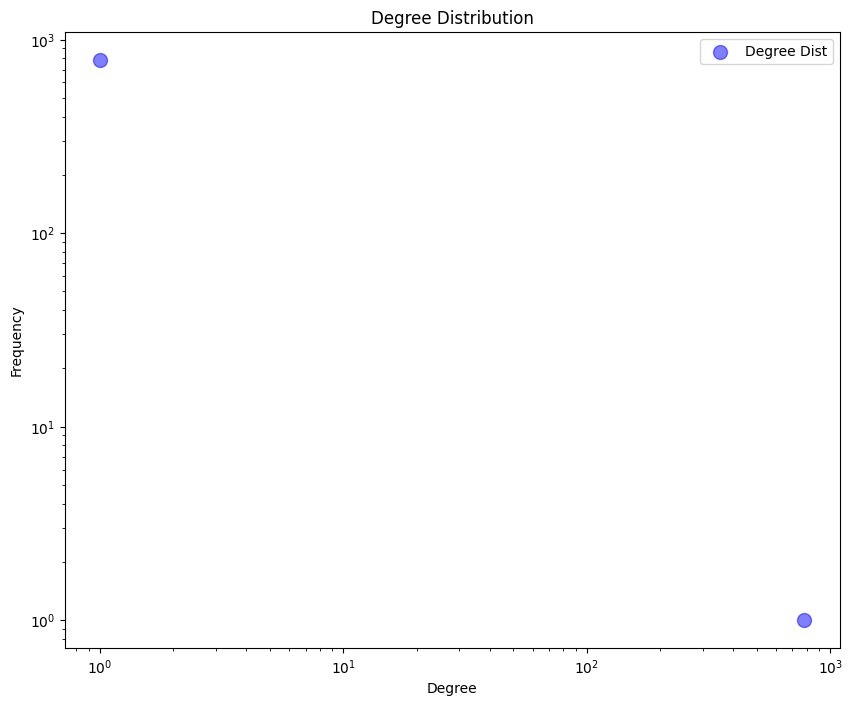

In [74]:
import collections

# compute degree distribution
deg = nx.degree(G)
deg = [deg[1] for deg in deg]
deg = collections.Counter(deg)

# create plot
fig = plt.figure(figsize=(10,8))
plt.title('Degree Distribution')
plt.xlabel('Degree')
plt.ylabel('Frequency')

ax = plt.gca()
ax.set_yscale('log')
ax.set_xscale('log')

ax.scatter(deg.keys(), deg.values(), alpha=0.5, color='b', s=100)
ax.legend(['Degree Dist'])

In [75]:
# compute empirical ccdf
ccdf = {}
tdeg = sum(deg.values())
for k in sorted(deg.items()):
    ccdf[k[0]] = tdeg
    tdeg -= k[1]
ccdf.pop(0,None)
    
logX = np.log(list(ccdf.keys()))
logy = np.log(list(ccdf.values()))

# create matrix and vectors
X = np.vstack([logX, np.ones(len(logX))]).T
y = logy

# compute least squares result
m, c = np.linalg.lstsq(X, y)[0]

# print result for alpha
alpha_ccdf = -m
alpha_hat2 = alpha_ccdf+1
print('Estimated CCDF alpha: {}'.format(alpha_ccdf))
print('Estimated PDF alpha 2: {}'.format(alpha_hat2))

Estimated CCDF alpha: 1.0001915501938563
Estimated PDF alpha 2: 2.0001915501938563


C:\Users\lawli\AppData\Local\Temp\ipykernel_11200\2398370632.py:17: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  m, c = np.linalg.lstsq(X, y)[0]
